In [63]:
# notebook formatter
import jupyter_black

jupyter_black.load()

Import scEGOT class and other libraries. We use os, glob, itertools, and pandas to read and reshape input data.

In [2]:
import os
import glob
import itertools
import pandas as pd
from scegot import scEGOT

Set constants

In [3]:
DATASET_INPUT_ROOT_PATH = os.path.join(os.getcwd(), "dataset/input/")

In [4]:
RANDOM_STATE = 2022
PCA_N_COMPONENTS = 30
GMM_CLUSTER_NUMBERS = [1, 2, 4, 5, 5]
UMAP_N_NEIGHBORS = 1000
UMAP_N_COMPONENTS = 2
DAY_NAMES = ["day 0", "day 0.5", "day 1", "day 1.5", "day 2"]

Read input files

In [5]:
input_file_paths = sorted(glob.glob(f"{DATASET_INPUT_ROOT_PATH}usedataSmall/*.csv"))
input_data = [
    pd.read_csv(input_file_path, index_col=0) for input_file_path in input_file_paths
]
print(f"number of days: {len(input_data)}")
print("shape of each day's data:")
for i, data in enumerate(input_data):
    print(f"    {DAY_NAMES[i]}: {data.shape}")
print("data example: ")
input_data[0].head()

number of days: 5
shape of each day's data:
    day 0: (4943, 2000)
    day 0.5: (1981, 2000)
    day 1: (551, 2000)
    day 1.5: (2562, 2000)
    day 2: (1753, 2000)
data example: 


,APOA1,ACTC1,CST1,KRT19,CALCB,GAL,CRH,APOA2,PLA2G2A,CTSV,...,PRICKLE1,RPL39L,PRR13,SYNE2,LOX,BTG2,FXYD4,YY1,AKR1D1,ZFHX3
iM_AAACCCACAACAACAA-1,0,5,0,23,0,105,0,0,0,9,...,2,18,4,11,0,0,0,17,0,0
iM_AAACGAAAGCTAGTTC-1,1,21,0,28,1,37,0,0,0,11,...,1,14,9,3,0,4,0,15,0,2
iM_AAACGAATCCTGCCAT-1,0,1,0,15,0,236,0,0,0,6,...,0,14,8,3,0,1,0,9,0,2
iM_AAACGAATCGACGATT-1,0,31,1,9,0,18,0,0,0,9,...,1,5,9,6,0,0,0,13,0,1
iM_AAACGAATCGCGGTAC-1,0,18,0,5,0,61,0,0,0,2,...,0,8,5,2,0,0,0,5,0,0


In [6]:
tf_gene_names = (
    pd.read_csv(
        f"{DATASET_INPUT_ROOT_PATH}TF_genes/TFgenes_name.csv", header=None, index_col=0
    )
    .T["cell"]
    .values
)
tf_gene_names

array(['ZBTB8B', 'GSX2', 'TBX2', ..., 'NME2', 'ZNF488', 'ZNF280B'],
      dtype=object)

# Tutorial

Create scEGOT instance.

In [78]:
scegot = scEGOT(
    input_data,
    PCA_N_COMPONENTS,
    GMM_CLUSTER_NUMBERS,
    day_names=["day 0", "day 0.5", "day 1", "day 1.5", "day 2"],
    verbose=True,
    target_sum=1e5,
)

## Preprocess:

Preprocess in the following order.

RECODE -> UMI normalize -> log1p normalize -> select variable genes -> PCA (-> UMAP)

To apply UMAP, call `apply_umap()` after `preprocess()`.

In [10]:
%%time
X, pca_model = scegot.preprocess(RANDOM_STATE, RANDOM_STATE)

Ex. X_new = screcode.RECODE(fast_algorithm=False).fit_transform(X)


Applying scRECODE...
start RECODE for scRNA-seq
end RECODE for scRNA-seq
log: {'seq_target': 'RNA', '#significant genes': 1987, '#non-significant genes': 10, '#silent genes': 0, 'ell': 492, 'Elapsed time': '0h 0m 22s 962ms'}
Applying UMI normalization...
Applying log1p normalization...
Applying PCA...
	sum of explained_variance_ratio = 69.6833876643948
CPU times: user 2min 49s, sys: 2.48 s, total: 2min 51s
Wall time: 31.5 s


In [11]:
%%time
scegot.umap_n_components = UMAP_N_COMPONENTS
X_umap, umap_model = scegot.apply_umap(
    n_neighbors=UMAP_N_NEIGHBORS, random_state=RANDOM_STATE, min_dist=0.8
)

CPU times: user 2min 11s, sys: 2.5 s, total: 2min 14s
Wall time: 1min 5s


## Apply GMM:

Apply GMM and visualize the results in each case of UMAP and PCA. To switch between PCA and UMAP displays, specify the mode argument to the plotting function.

In [13]:
%%time
gmm_models, gmm_labels = scegot.fit_predict_gmm(random_state=RANDOM_STATE)

Fitting GMM models with each day's data and predicting labels for them...


100%|██████████| 5/5 [04:28<00:00, 53.62s/it]

CPU times: user 28min 43s, sys: 39.8 s, total: 29min 22s
Wall time: 4min 28s


Visualization in PCA

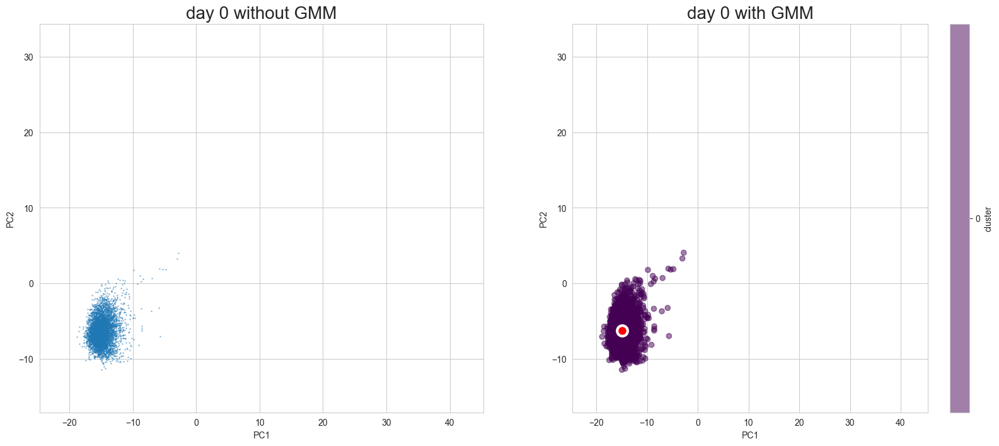

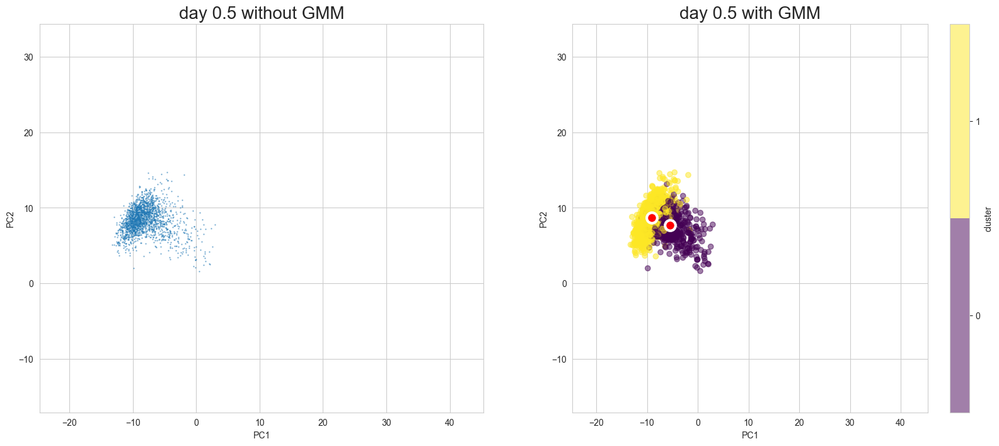

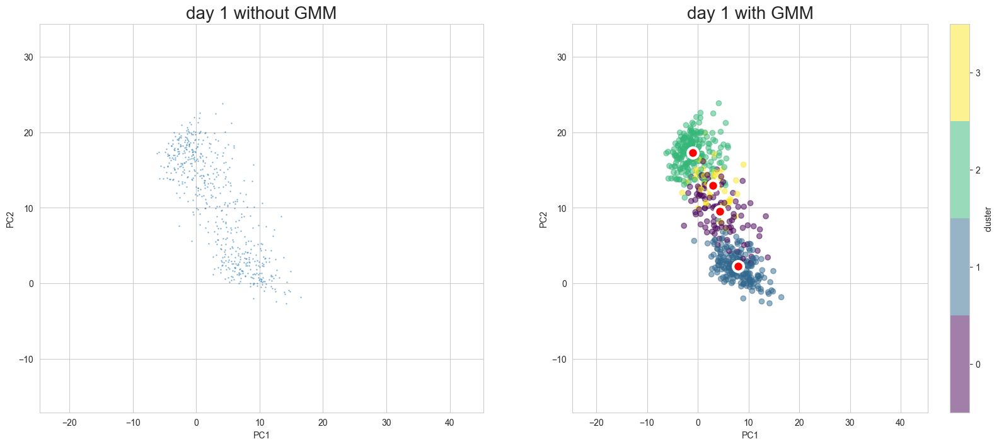

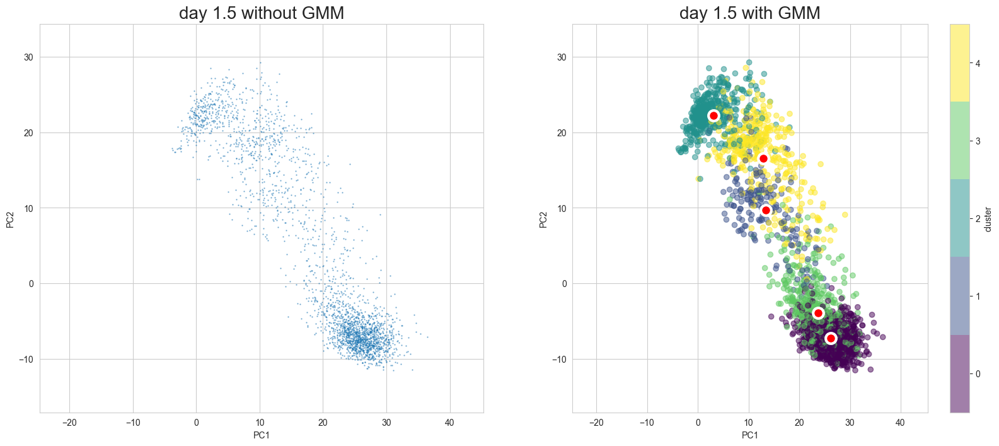

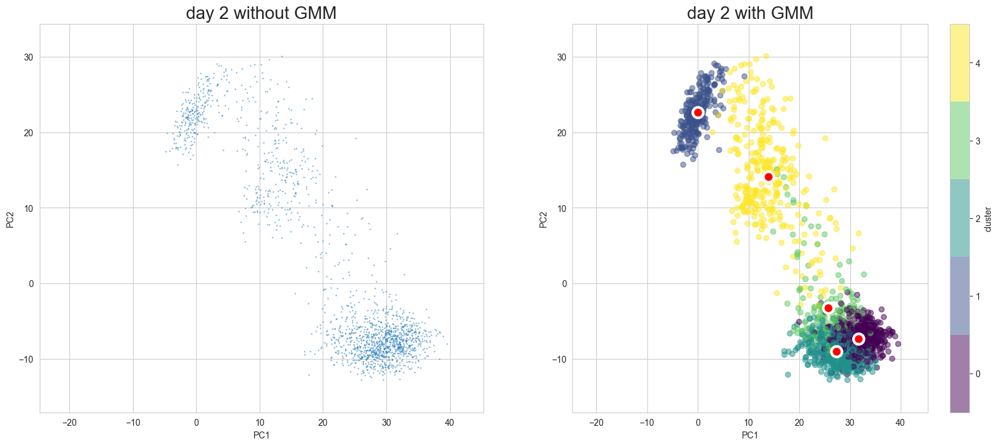

In [52]:
scegot.plot_gmm_predictions(
    plot_gmm_means=True,
    figure_titles_without_gmm=[f"{name} without GMM" for name in DAY_NAMES],
    figure_titles_with_gmm=[f"{name} with GMM" for name in DAY_NAMES],
    cmap="viridis",
)

Visualization in UMAP

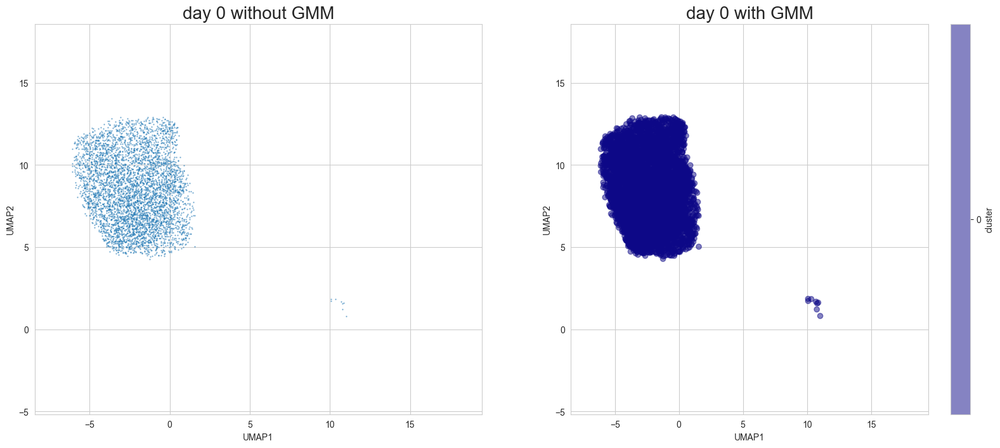

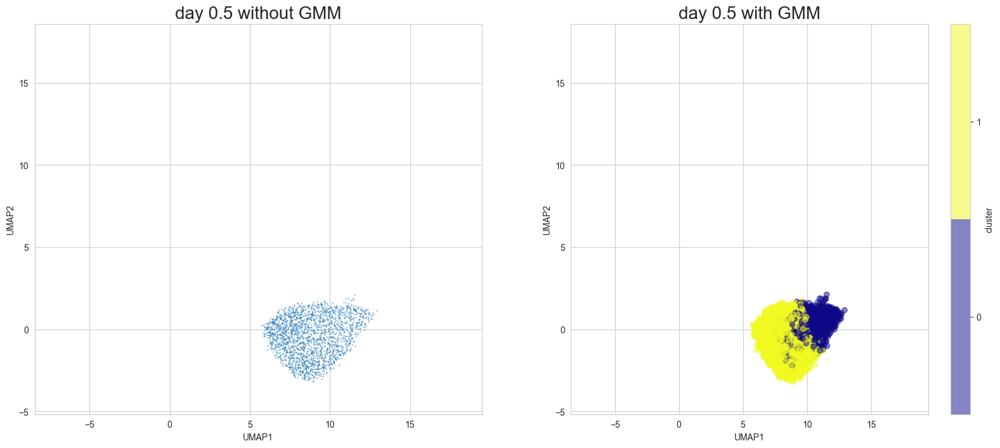

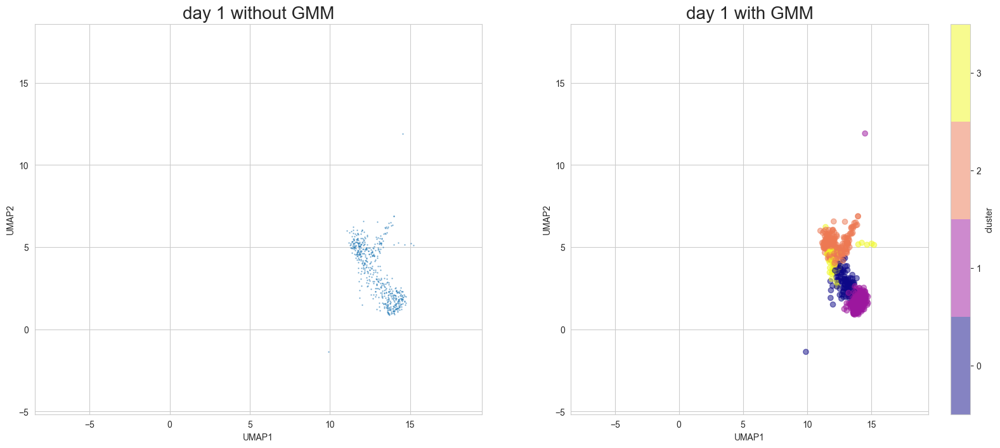

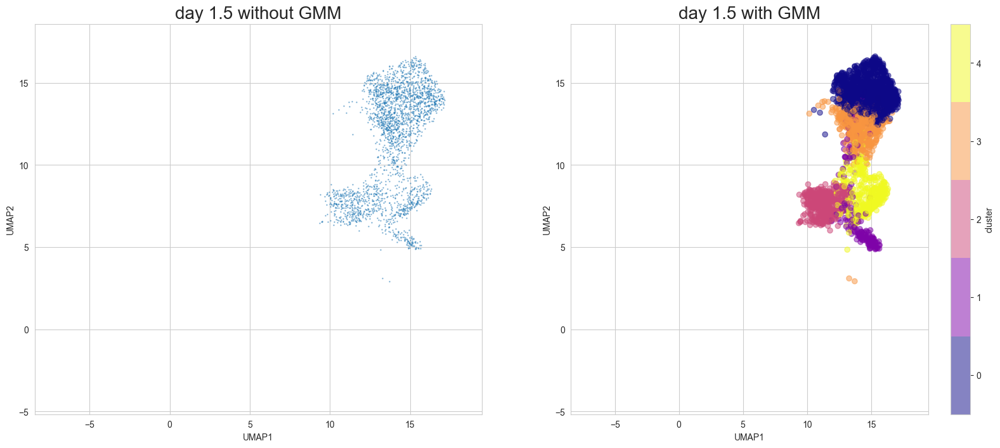

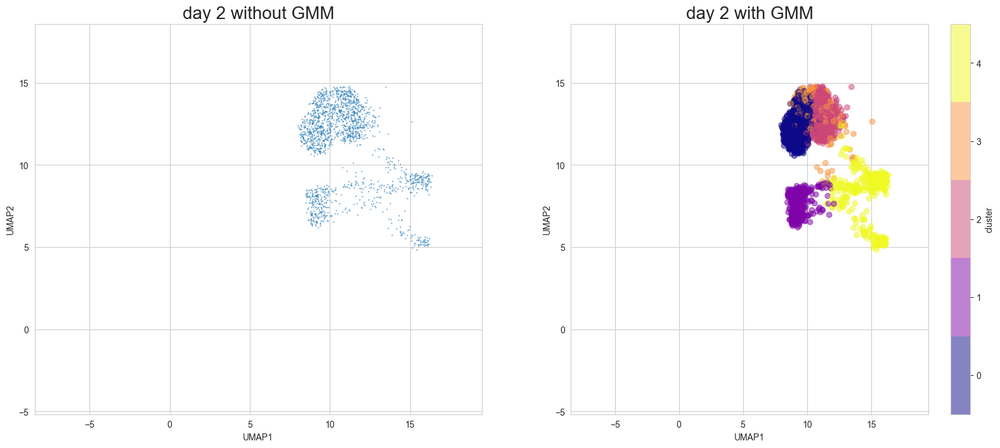

In [54]:
scegot.plot_gmm_predictions(
    mode="umap",
    figure_titles_without_gmm=[f"{name} without GMM" for name in DAY_NAMES],
    figure_titles_with_gmm=[f"{name} with GMM" for name in DAY_NAMES],
    cmap="plasma",
)

## Cell State:

You can visualize cell state in two patterns: animated and graphical

### Animation

Interpolating between day 0 and day 0.5...


100%|██████████| 11/11 [00:04<00:00,  2.25it/s]


Interpolating between day 0.5 and day 1...


100%|██████████| 10/10 [00:08<00:00,  1.25it/s]


Interpolating between day 1 and day 1.5...


100%|██████████| 10/10 [00:20<00:00,  2.10s/it]


Interpolating between day 1.5 and day 2...


100%|██████████| 10/10 [00:24<00:00,  2.44s/it]


Creating animation...


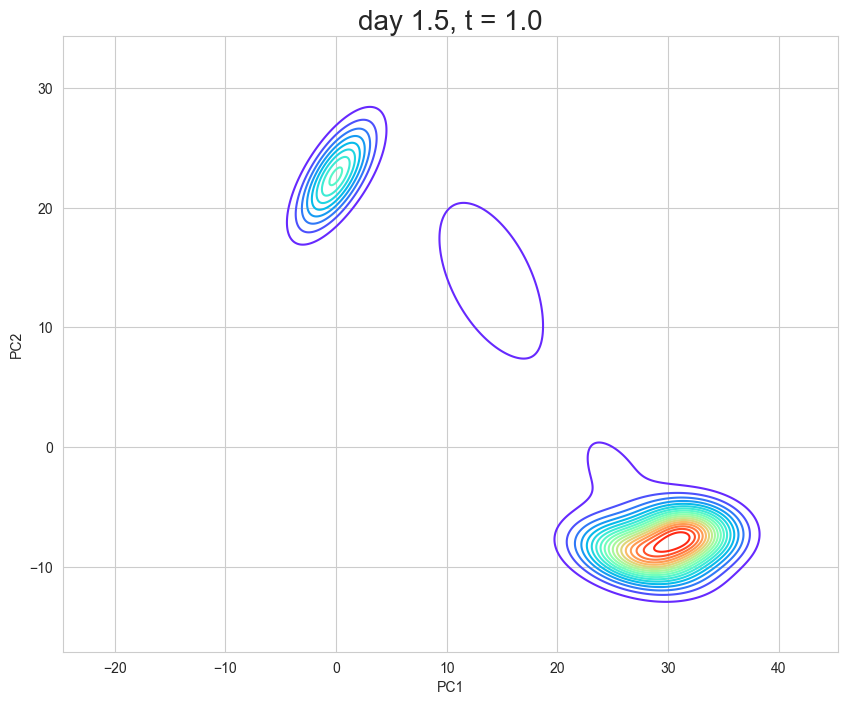

In [13]:
scegot.animate_cell_state(
    cmap="rainbow",
)

### Graph

There are two functions for visualizing cell state graphs, one is `plot_cell_state_graph()` and the other is `plot_simple_cell_state_graph()`. Both can visualize PCA and UMAP.

Before plotting the graph, call `make_cell_state_graph()` to create a graph object. At that time, cluster names must be specified as an array. Of course, you can create them manually, or there is a function called `generate_cluster_names_with_day(`) that automatically generates cluster names for you.

Since cluster names are not maintained in the scEGOT class, an array of cluster names must be passed to the function that draws the cluster names each time.

There will be other occasions where cluster names are passed in the `pathway` and `cell velocity` sections, but it is not necessary for the cluster names in those cases to match the cluster names used in this section. Therefore, the cluster name can be changed flexibly.

In [14]:
cluster_names = scegot.generate_cluster_names_with_day()
cluster_names

[['day 0-0'],
 ['day 0.5-0', 'day 0.5-1'],
 ['day 1-0', 'day 1-1', 'day 1-2', 'day 1-3'],
 ['day 1.5-0', 'day 1.5-1', 'day 1.5-2', 'day 1.5-3', 'day 1.5-4'],
 ['day 2-0', 'day 2-1', 'day 2-2', 'day 2-3', 'day 2-4']]

#### In the case of  `plot_cell_state_graph()`

* Gene information is displayed in the graph.

PCA ver.

In [16]:
G = scegot.make_cell_state_graph(cluster_names)
scegot.plot_cell_state_graph(
    G,
    cluster_names,
    tf_gene_names,
)

UMAP ver.

In [15]:
G_umap = scegot.make_cell_state_graph(cluster_names, mode="umap")
scegot.plot_cell_state_graph(
    G_umap,
    cluster_names,
    tf_gene_names,
)

#### In the case of `plot_simple_cell_state_graph()`

* The shape of the graph can be changed by changing the layout argument.
* When `layout="hierarchy"` and `order="weight"`, the nodes are sorted in order of node weight.
  * If the order argument is not specified, the nodes are sorted in the order of their gmm labels.

PCA ver.

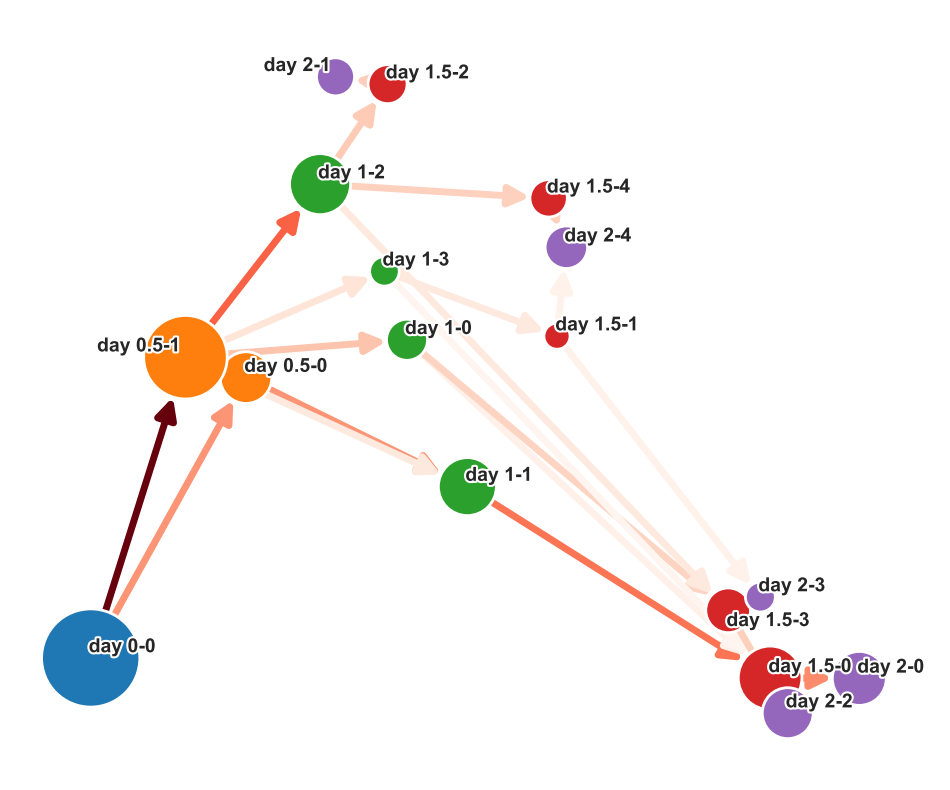

In [17]:
G = scegot.make_cell_state_graph(cluster_names)
scegot.plot_simple_cell_state_graph(
    G,
    layout="normal",
)

UMAP ver.

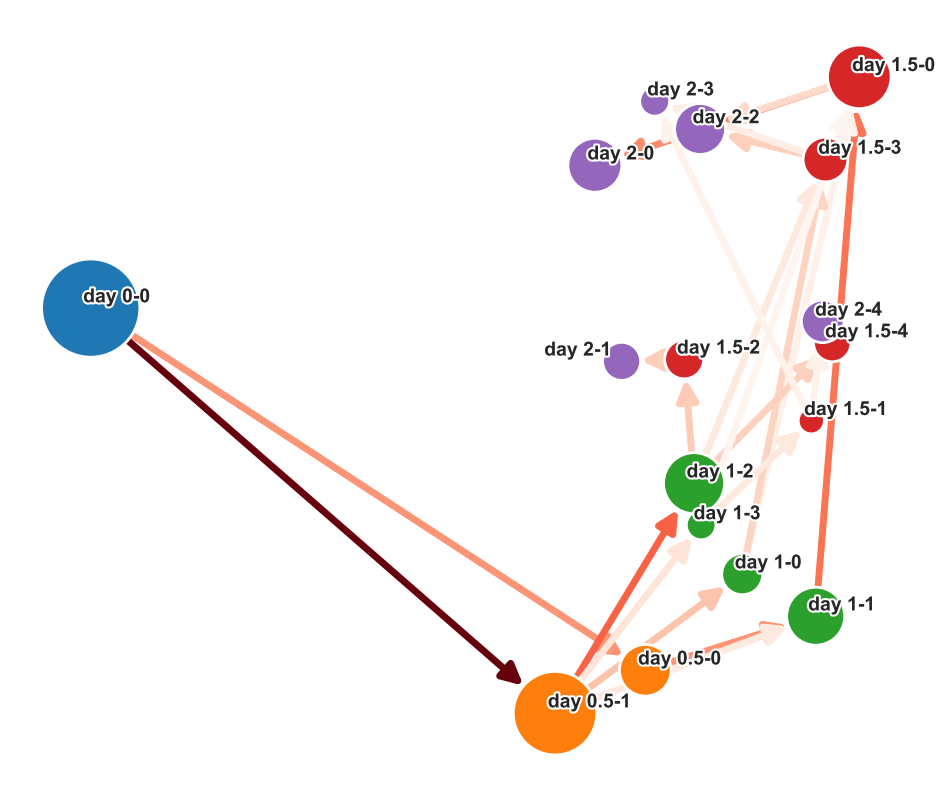

In [18]:
G_umap = scegot.make_cell_state_graph(cluster_names, mode="umap")
scegot.plot_simple_cell_state_graph(
    G_umap,
)

layout="hierarchy"

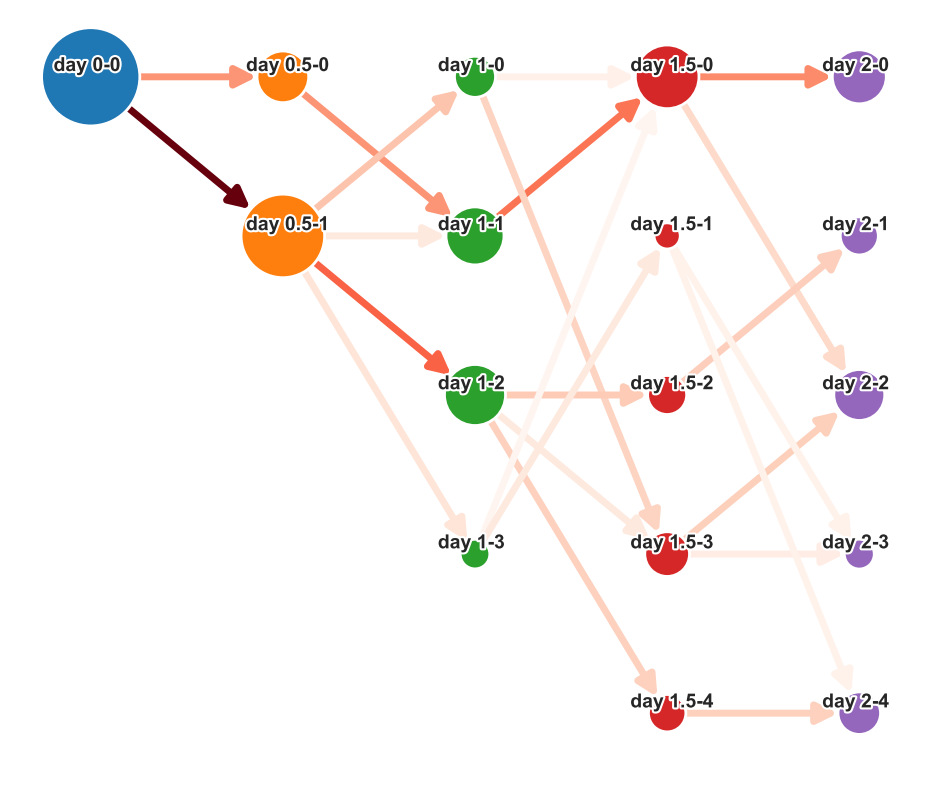

In [19]:
G = scegot.make_cell_state_graph(cluster_names)
scegot.plot_simple_cell_state_graph(
    G,
    layout="hierarchy",
)

layout="hierarchy" and order="weight"

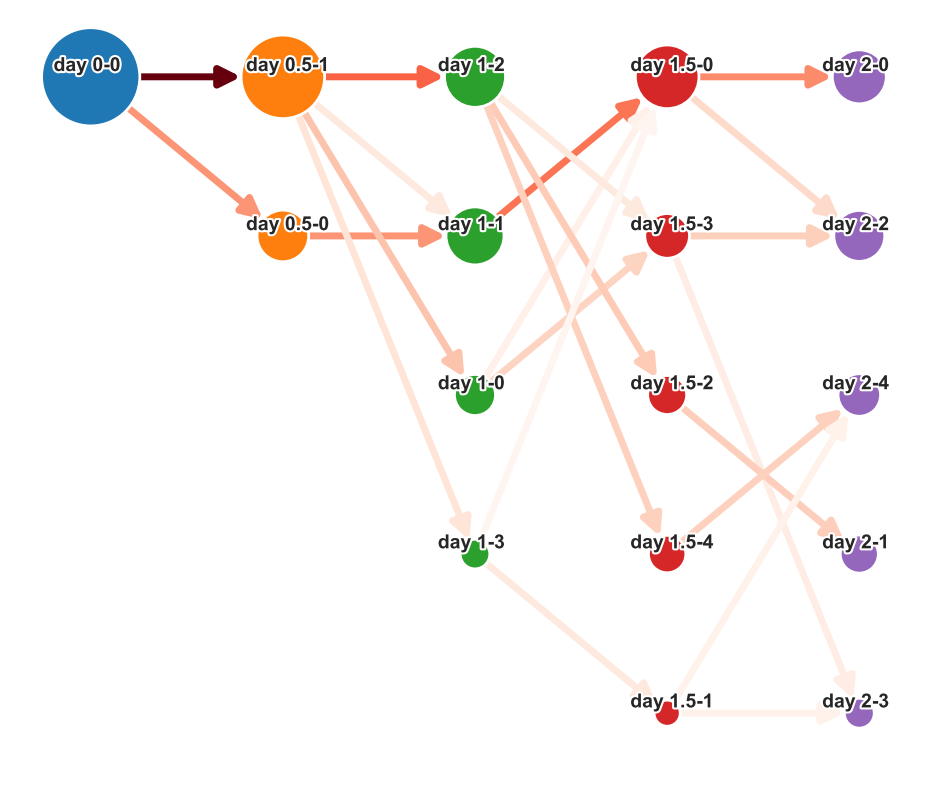

In [20]:
G = scegot.make_cell_state_graph(cluster_names)
scegot.plot_simple_cell_state_graph(
    G,
    layout="hierarchy",
    order="weight",
)

## Fold Change:

You can see the fold change between the two clusters.

In [21]:
cluster1 = "day 0.5-0"
cluster2 = "day 0.5-1"
scegot.plot_fold_change(
    cluster_names,
    tf_gene_names,
    cluster1,
    cluster2,
    threshold=1.0,
)

## Pathway:

Visualize the transition of expression levels of `selected_genes` in the clusters specified by `pathway_names`.

In [22]:
pathway_names = [
    "day 0-0",
    "day 0.5-1",
    "day 1-1",
    "day 1.5-4",
    "day 2-2",
]
selected_genes = ["NANOG", "SOX17", "TFAP2C", "NKX1-2"]
scegot.plot_pathway_gene_expressions(
    cluster_names,
    tf_gene_names,
    pathway_names,
    selected_genes,
    save=True,
    save_path="./output/library/pathway_gene_expressions.png",
)

## Features of single gene:

You can also plot only the features of a single gene.

### 2D

PCA ver.

In [23]:
gene_name = "NKX1-2"
scegot.plot_pathway_single_gene_2d(
    gene_name,
)

UMAP ver.

In [24]:
gene_name = "NKX1-2"
scegot.plot_pathway_single_gene_2d(gene_name, mode="umap")

### 3D

In [25]:
gene_name = "NKX1-2"
scegot.plot_pathway_single_gene_3d(
    gene_name,
)

## Interpolation:

### Accuracy check of interpolation

For each of PCA and UMAP, interpolated and correct data can be compared. Also, source and target can be toggled on and off.

PCA ver.

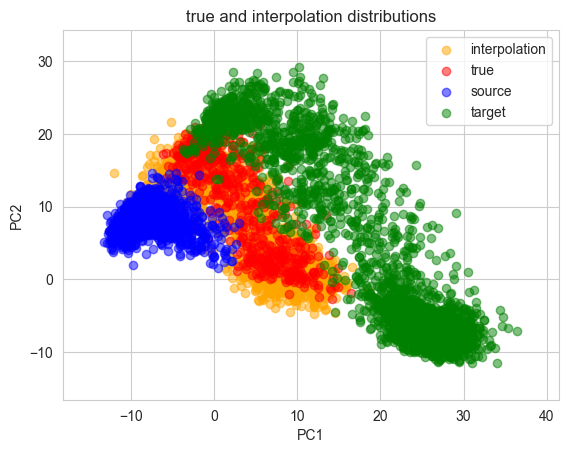

<Figure size 640x480 with 0 Axes>

In [27]:
scegot.plot_true_and_interpolation_distributions(
    2,
    alpha_true=0.5,
)

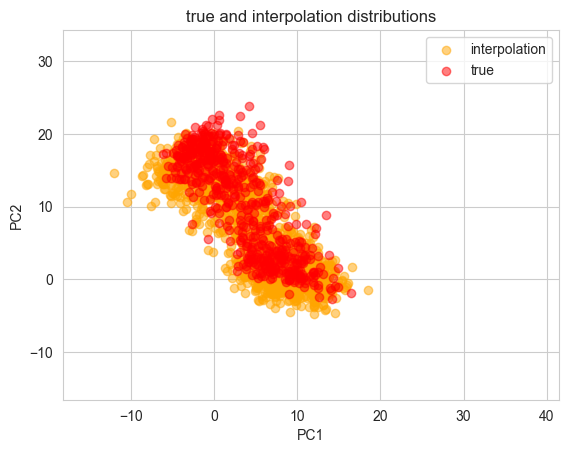

<Figure size 640x480 with 0 Axes>

In [26]:
scegot.plot_true_and_interpolation_distributions(
    2,
    plot_source_and_target=False,
    alpha_true=0.5,
)

UMAP ver.

Transforming interpolated data with UMAP...


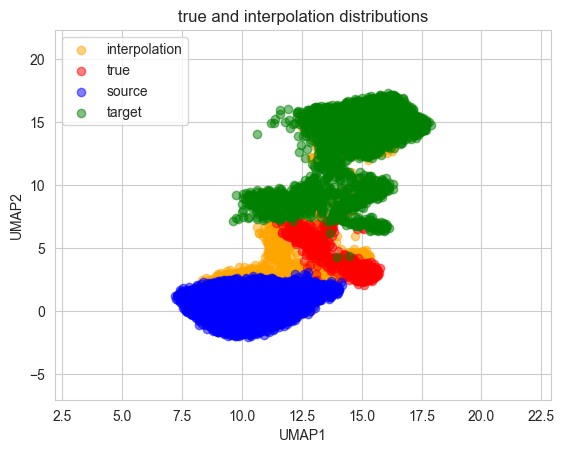

<Figure size 640x480 with 0 Axes>

In [30]:
scegot.plot_true_and_interpolation_distributions(
    2,
    alpha_true=0.5,
    mode="umap",
)

Transforming interpolated data with UMAP...


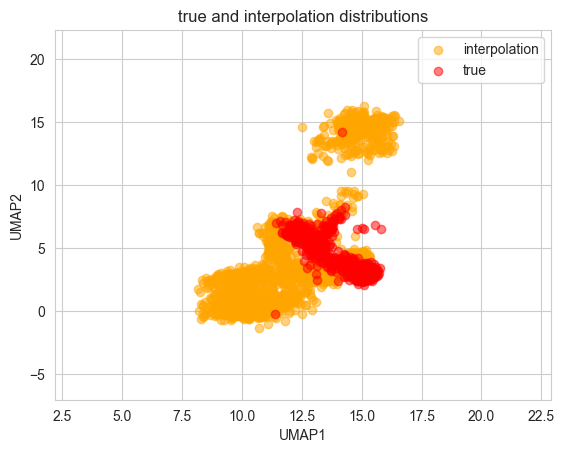

<Figure size 640x480 with 0 Axes>

In [29]:
scegot.plot_true_and_interpolation_distributions(
    2,
    plot_source_and_target=False,
    alpha_true=0.5,
    mode="umap",
)

### Video visualization of feature changes in a single gene

PCA ver.

Interpolating between day 0 and day 0.5...


100%|██████████| 11/11 [00:00<00:00, 14.43it/s]


Interpolating between day 0.5 and day 1...


100%|██████████| 10/10 [00:01<00:00,  9.24it/s]


Interpolating between day 1 and day 1.5...


100%|██████████| 10/10 [00:01<00:00,  7.00it/s]


Interpolating between day 1.5 and day 2...


100%|██████████| 10/10 [00:01<00:00,  6.59it/s]


Creating animation...


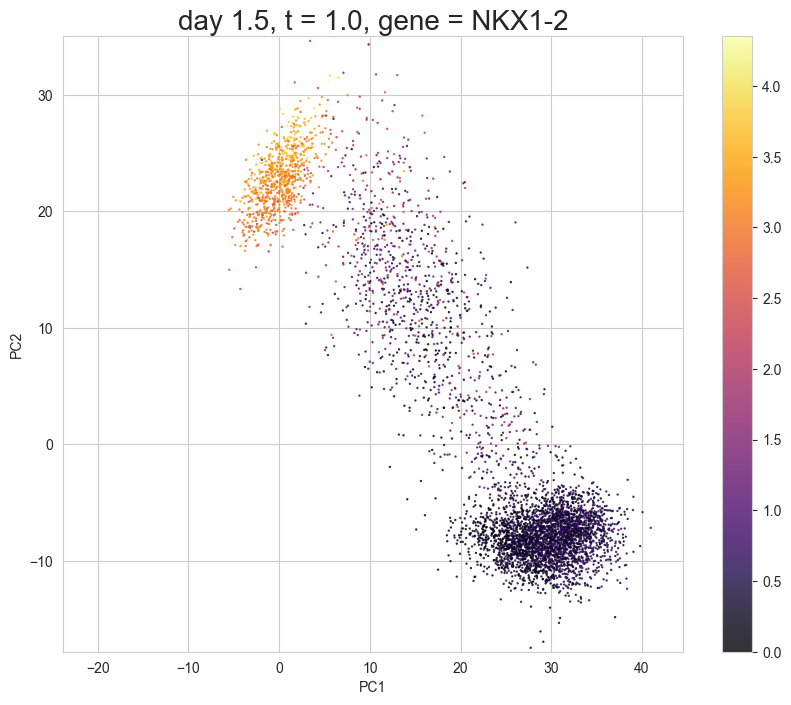

In [28]:
target_gene = "NKX1-2"
scegot.animate_interpolation(
    target_gene,
    interpolate_interval=11,
    cmap="inferno",
)

UMAP ver.

Interpolating between day 0 and day 0.5...


100%|██████████| 11/11 [05:22<00:00, 29.35s/it]


Interpolating between day 0.5 and day 1...


100%|██████████| 10/10 [04:43<00:00, 28.32s/it]


Interpolating between day 1 and day 1.5...


100%|██████████| 10/10 [04:44<00:00, 28.46s/it]


Interpolating between day 1.5 and day 2...


100%|██████████| 10/10 [04:44<00:00, 28.45s/it]


Creating animation...


CPU times: user 20min 21s, sys: 26.6 s, total: 20min 48s
Wall time: 19min 41s


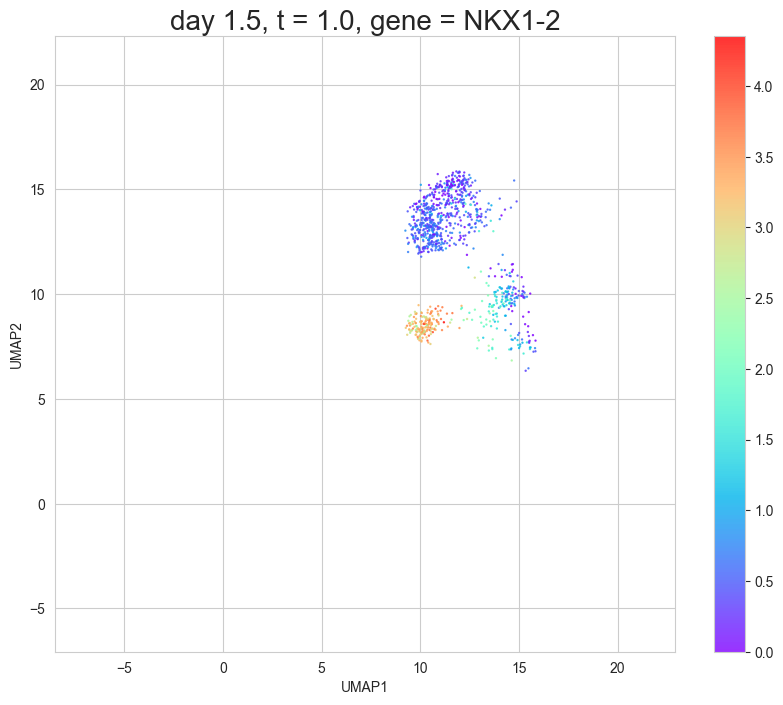

In [31]:
%%time
target_gene = "NKX1-2"
scegot.animate_interpolation(
    target_gene,
    interpolate_interval=11,
    n_samples=1000,
    mode="umap",
)

## Cell velocity:

### Plotting cell velocity

After the velocity is calculated using `calculate_cell_velocities()`, visualize it with `plot_cell_velocity()`. Both PCA and UMAP are supported.

PCA ver.

In [28]:
velocities = scegot.calculate_cell_velocities()

Calculating cell velocities between each day...


100%|██████████| 4/4 [00:05<00:00,  1.30s/it]


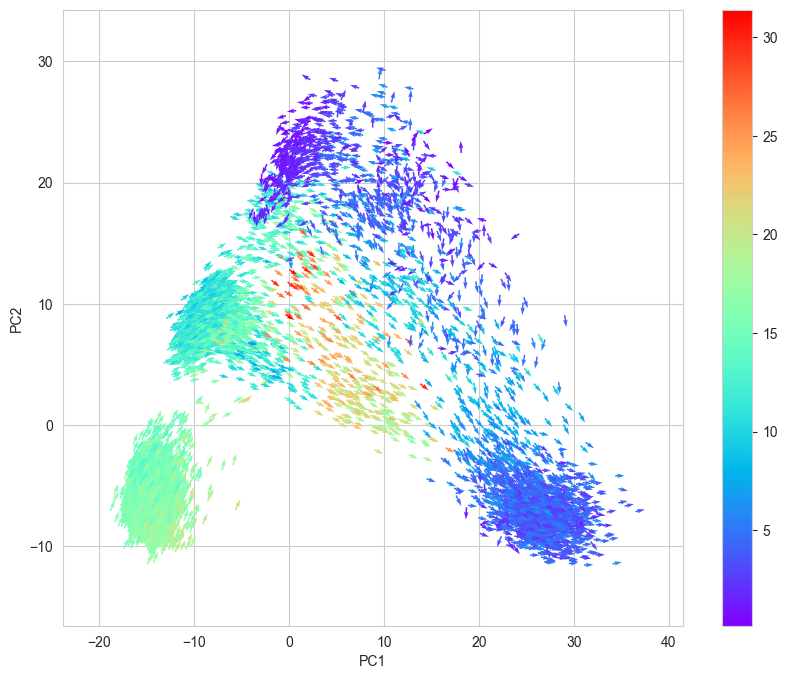

In [29]:
scegot.plot_cell_velocity(
    velocities,
    cmap="rainbow",
)

UMAP ver.

In [30]:
%%time
velocities_umap = scegot.calculate_cell_velocities(mode="umap")

Calculating cell velocities between each day...


100%|██████████| 4/4 [04:51<00:00, 72.82s/it] 

CPU times: user 5min, sys: 3.22 s, total: 5min 4s
Wall time: 4min 51s


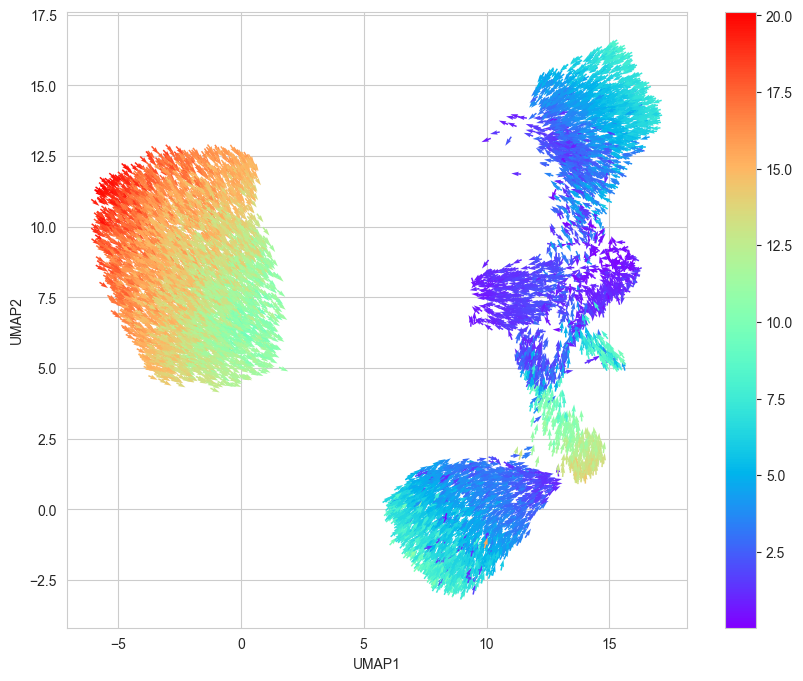

CPU times: user 652 ms, sys: 17.1 ms, total: 669 ms
Wall time: 282 ms


In [31]:
%%time
scegot.plot_cell_velocity(
    velocities_umap,
    mode="umap",
    cmap="rainbow",
)

### Interpolation of cell velocity

You can color the clusters and / or the streams.

PCA ver.

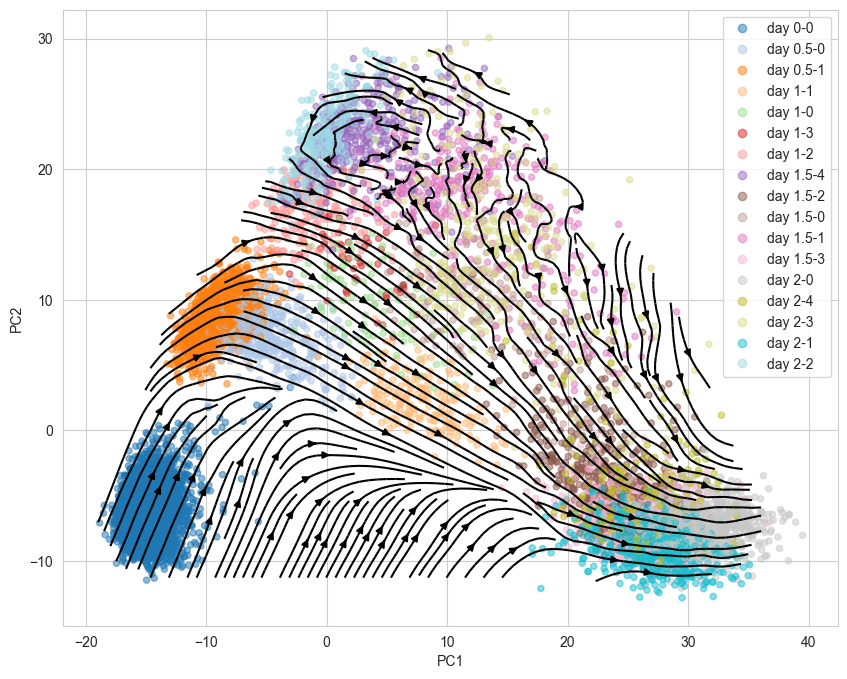

<Figure size 640x480 with 0 Axes>

In [301]:
scegot.plot_interpolation_of_cell_velocity(
    velocities,
    cluster_names=list(itertools.chain.from_iterable(cluster_names)),
    cmap="tab20",
)

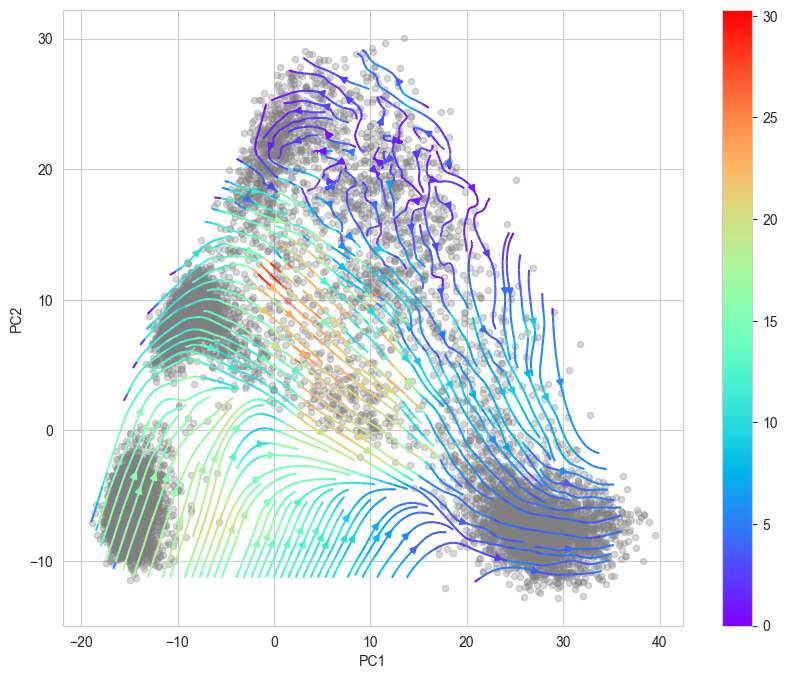

<Figure size 640x480 with 0 Axes>

In [36]:
scegot.plot_interpolation_of_cell_velocity(
    velocities,
    color_streams=True,
    color_points=None,
    cmap="rainbow",
)

UMAP ver.

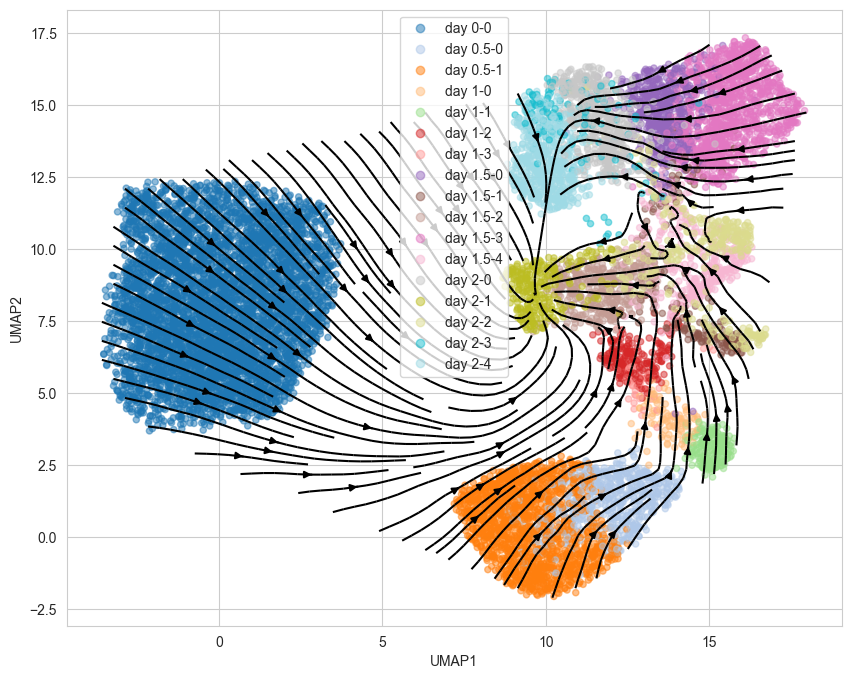

<Figure size 640x480 with 0 Axes>

In [83]:
scegot.plot_interpolation_of_cell_velocity(
    velocities_umap_new,
    mode="umap",
    cluster_names=list(itertools.chain.from_iterable(cluster_names)),
    cmap="tab20",
)

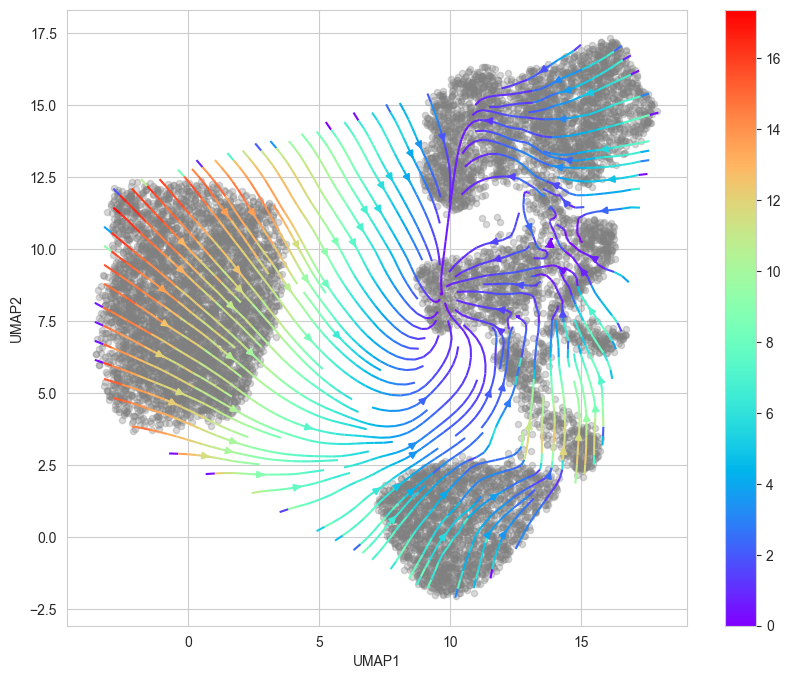

<Figure size 640x480 with 0 Axes>

In [84]:
scegot.plot_interpolation_of_cell_velocity(
    velocities_umap_new,
    mode="umap",
    color_streams=True,
    color_points=None,
    cmap="rainbow",
)

## Gene regulatory network:

You can visualize the Gene regulatory network between genes specified in `selected_genes`.

In [15]:
%%time
GRNs, ridgeCVs = scegot.calculate_grns()

Calculating GRNs between each day...


100%|██████████| 4/4 [00:13<00:00,  3.49s/it]

CPU times: user 1min 11s, sys: 1 s, total: 1min 12s
Wall time: 14.1 s


alpha = 0.18329807108324356


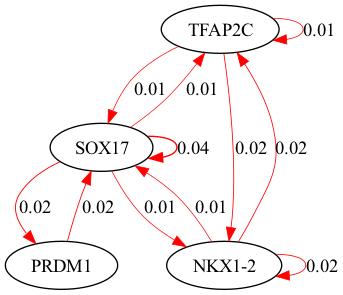

alpha = 37.92690190732246


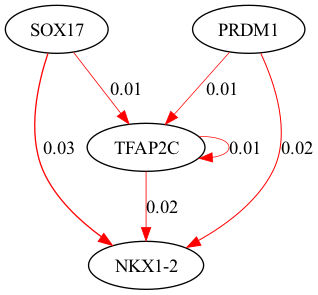

alpha = 23.357214690901213


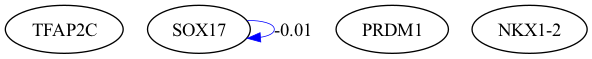

alpha = 100.0


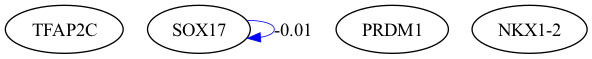

In [16]:
selected_genes = ["TFAP2C", "SOX17", "PRDM1", "NKX1-2"]
scegot.plot_grn_graph(
    GRNs,
    ridgeCVs,
    selected_genes,
)

You can also specify the clusters to use.

In [83]:
%%time
cluster_set_PGC = [[0, 0], [1, 0], [2, 0], [3, 0]]
GRNs_cluster, ridgeCVs_cluster = scegot.calculate_grns(
    selected_clusters=cluster_set_PGC
)

Calculating GRNs between each day...


100%|██████████| 4/4 [00:10<00:00,  2.64s/it]

CPU times: user 53.1 s, sys: 777 ms, total: 53.9 s
Wall time: 10.6 s


alpha = 0.18329807108324356


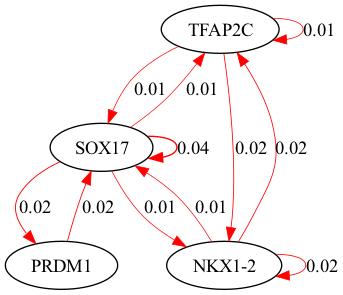

alpha = 8.858667904100823


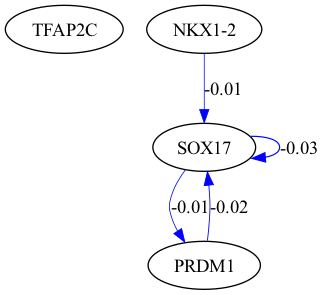

alpha = 3.359818286283781


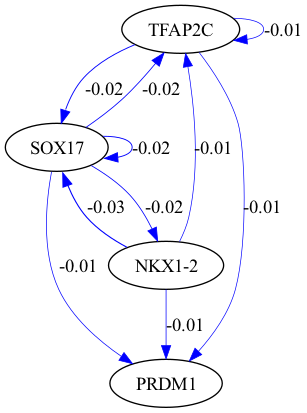

alpha = 8.858667904100823


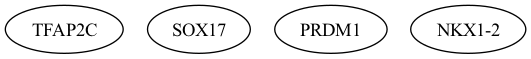

In [84]:
selected_genes = ["TFAP2C", "SOX17", "PRDM1", "NKX1-2"]
scegot.plot_grn_graph(
    GRNs_cluster,
    ridgeCVs_cluster,
    selected_genes,
)

## Waddington Landscape:

Both PCA and UMAP are supported.

In [32]:
%%time
Wpotential, F_all = scegot.calculate_waddington_potential()

Calculating F between each day...


100%|██████████| 4/4 [01:03<00:00, 15.91s/it]


Applying knn ...
Computing kernel ...
CPU times: user 6min 44s, sys: 15.7 s, total: 6min 59s
Wall time: 1min 6s


In [33]:
%%time
Wpotential_umap, F_all_umap = scegot.calculate_waddington_potential(knn_mode="umap")

Calculating F between each day...


  0%|          | 0/4 [00:00<?, ?it/s]

100%|██████████| 4/4 [01:01<00:00, 15.25s/it]


Applying knn ...
Computing kernel ...
CPU times: user 6min 39s, sys: 12.9 s, total: 6min 52s
Wall time: 1min 3s


Plots Waddington potential in 3 dimensions. You can also select a single gene and color it by expression level.

PCA ver.

In [34]:
scegot.plot_waddington_potential(Wpotential)

In [35]:
gene_name = "NKX1-2"
scegot.plot_waddington_potential(
    Wpotential,
    gene_name,
)

UMAP ver.

In [39]:
scegot.plot_waddington_potential(Wpotential_umap)

In [40]:
gene_name = "NKX1-2"
scegot.plot_waddington_potential(
    Wpotential_umap,
    gene_name,
)

You can also display a landscape instead of a plot of points.

PCA ver.

In [37]:
scegot.plot_waddington_potential_surface(
    Wpotential,
)

UMAP ver.

In [41]:
scegot.plot_waddington_potential_surface(
    Wpotential_umap,
)